In [2]:
import cv2
import numpy as np
from PIL import Image

from torchvision.transforms.functional import to_pil_image

/home/jonathan/miniforge3/envs/fsr_dlnr/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm

A module that was compiled using NumPy 1.x cannot be run in
NumPy 2.2.6 as it may crash. To support both 1.x and 2.x
versions of NumPy, modules must be compiled with NumPy 2.0.
Some module may need to rebuild instead e.g. with 'pybind11>=2.12'.

If you are a user of the module, the easiest solution will be to
downgrade to 'numpy<2' or try to upgrade the affected module.
We expect that some modules will need time to support NumPy 2.

Traceback (most recent call last):  File "/home/jonathan/miniforge3/envs/fsr_dlnr/lib/python3.10/runpy.py", line 196, in _run_module_as_main
    return _run_code(code, main_globals, None,
  File "/home/jonathan/miniforge3/envs/fsr_dlnr/lib/python3.10/runpy.py", line 86, in _run_code
    

In [3]:
def apply_wls_filter(disparity, img_left, img_right, stereo_matcher, lambda_val=8000, sigma=1.5):
    """Apply WLS filter for edge-aware smoothing"""
    right_matcher = cv2.ximgproc.createRightMatcher(stereo_matcher)
    
    disparity_right = right_matcher.compute(img_right, img_left).astype(np.float32) / 16.0
    
    wls_filter = cv2.ximgproc.createDisparityWLSFilter(stereo_matcher)
    wls_filter.setLambda(lambda_val)
    wls_filter.setSigmaColor(sigma)
    
    return wls_filter.filter(disparity, img_left, disparity_map_right=disparity_right)

def visualize_disparity(disparity, reference_img, colormap=cv2.COLORMAP_INFERNO):
    """Convert disparity to colormap and create side-by-side visualization"""
    # Mask invalid disparities
    disparity_viz = disparity.copy()
    disparity_viz[disparity < 0] = 0
    
    # Normalize to 0-255
    disp_uint8 = cv2.normalize(disparity_viz, None, 0, 255, cv2.NORM_MINMAX, dtype=cv2.CV_8U)
    
    # Apply colormap
    disp_color = cv2.applyColorMap(disp_uint8, colormap)
    disp_color_rgb = cv2.cvtColor(disp_color, cv2.COLOR_BGR2RGB)
    
    # Create side-by-side comparison
    h, w = reference_img.shape[:2]
    combined = Image.new('RGB', (2 * w, h))
    combined.paste(Image.fromarray(reference_img), (0, 0))
    combined.paste(Image.fromarray(disp_color_rgb), (w, 0))
    
    return combined, disp_uint8

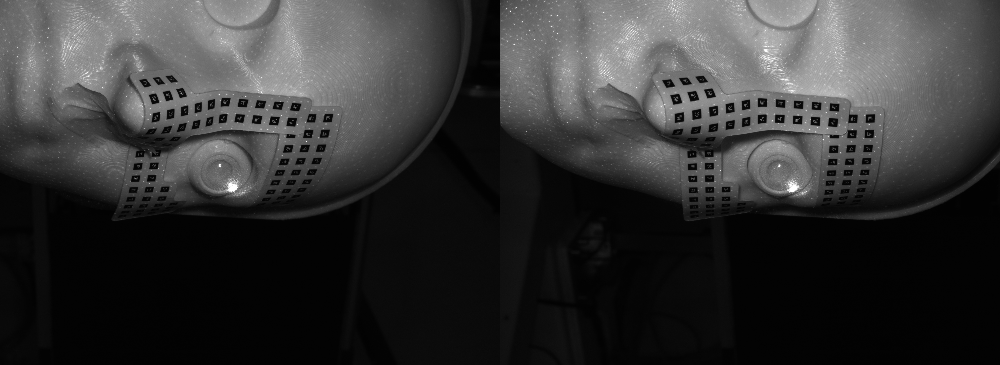

In [4]:
path = '/home/jonathan/Github/FSR_DLNR/face_laser_projector/ID_5_2025-11-03_16-22-31/Face_Reconstruction_log/scan001/'
number = '00125'
path1 = path + number + '_left.jpg'
path2 = path + number + '_right.jpg'

# Read as grayscale
img1 = cv2.imread(path1, cv2.IMREAD_GRAYSCALE)
img2 = cv2.imread(path2, cv2.IMREAD_GRAYSCALE)

# Convert from OpenCV (NumPy arrays) to PIL images
img1_pil = Image.fromarray(img1)
img2_pil = Image.fromarray(img2)

# combine 
w, h = img1_pil.size
combined = Image.new('L', (2 * w, h)) 
combined.paste(img1_pil, (0, 0))
combined.paste(img2_pil, (w, 0))
display(combined)

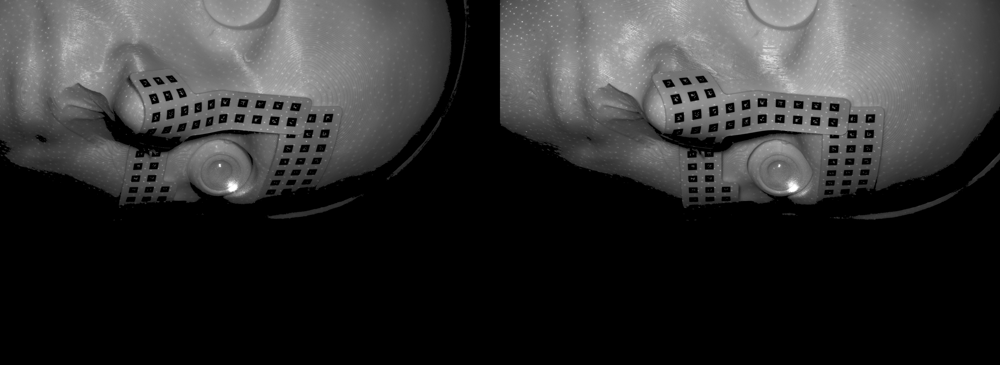

In [5]:
# --- Create brightness mask ---
# adjust threshold (e.g., 50–100) depending on your lighting
threshold = 40
mask1 = np.uint8(img1 > threshold) * 255
mask2 = np.uint8(img2 > threshold) * 255

# clean up masks using morph operators
kernel = np.ones((3, 3), np.uint8)
mask1 = cv2.morphologyEx(mask1, cv2.MORPH_OPEN, kernel)
mask2 = cv2.morphologyEx(mask2, cv2.MORPH_OPEN, kernel)

# --- Apply mask: keep only bright pixels ---
img1_masked = cv2.bitwise_and(img1, img1, mask=mask1)
img2_masked = cv2.bitwise_and(img2, img2, mask=mask2)

# Convert from OpenCV (NumPy arrays) to PIL images
img1_pil = Image.fromarray(img1_masked)
img2_pil = Image.fromarray(img2_masked)

# combine 
w, h = img1_pil.size
combined = Image.new('L', (2 * w, h)) 
combined.paste(img1_pil, (0, 0))
combined.paste(img2_pil, (w, 0))
display(combined)

In [6]:
block_size = 15
min_disp = 0
max_disp = 64
num_disp = max_disp - min_disp
block_factor = 1

stereo = cv2.StereoSGBM.create(
    minDisparity      = min_disp,
    numDisparities    = num_disp,
    blockSize         = block_size,
    P1                = 8 * block_factor * block_size**2,
    P2                = 32 * block_factor * block_size**2,
    disp12MaxDiff     = 1,
    # uniquenessRatio   = 5,
    speckleWindowSize = 0,
    speckleRange      = 0,
    mode              = cv2.STEREO_SGBM_MODE_SGBM_3WAY
)

# compute disparity and depth map
disparity = stereo.compute(img1_masked, img2_masked).astype(np.float32) / 16.0

# cast
disparity_valid = np.clip(disparity, min_disp, max_disp)
disp_uint8 = cv2.normalize(disparity_valid, None, 0, 255, cv2.NORM_MINMAX, dtype=cv2.CV_8U)

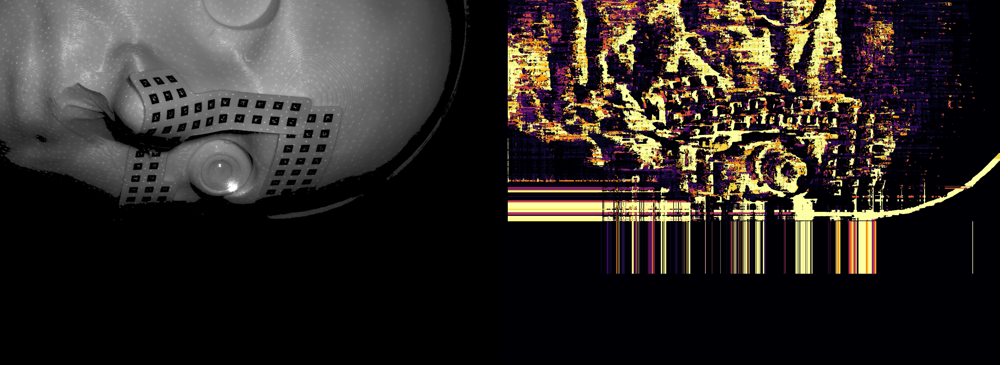

In [7]:
combined_viz, _ = visualize_disparity(disparity, img1_masked)
display(combined_viz)

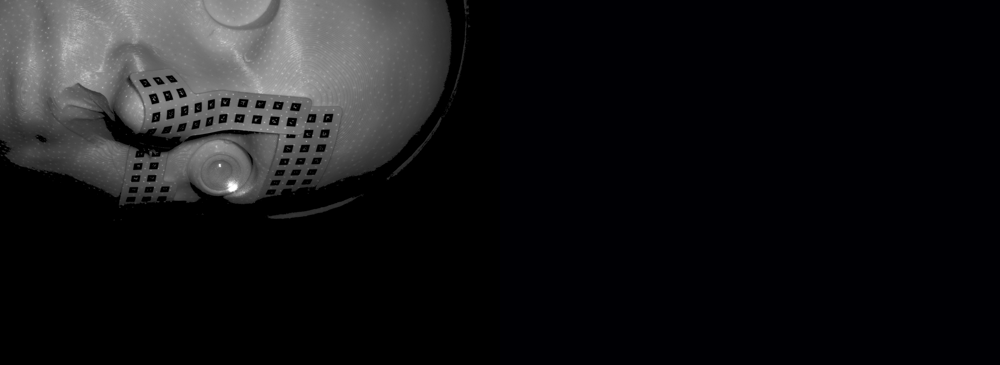

In [8]:
disparity_filtered = apply_wls_filter(disparity, img1_masked, img2_masked, stereo, lambda_val=1, sigma=1.0)
combined_viz, disp_normalized = visualize_disparity(disparity_filtered, img1_masked)
display(combined_viz)